## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---
## First, I'll compute the camera calibration using chessboard images

In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
%matplotlib inline

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(8,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('./camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        #img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        #cv2.imshow('img',img)
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)

## Undistort Images Using Distortion Coefficients

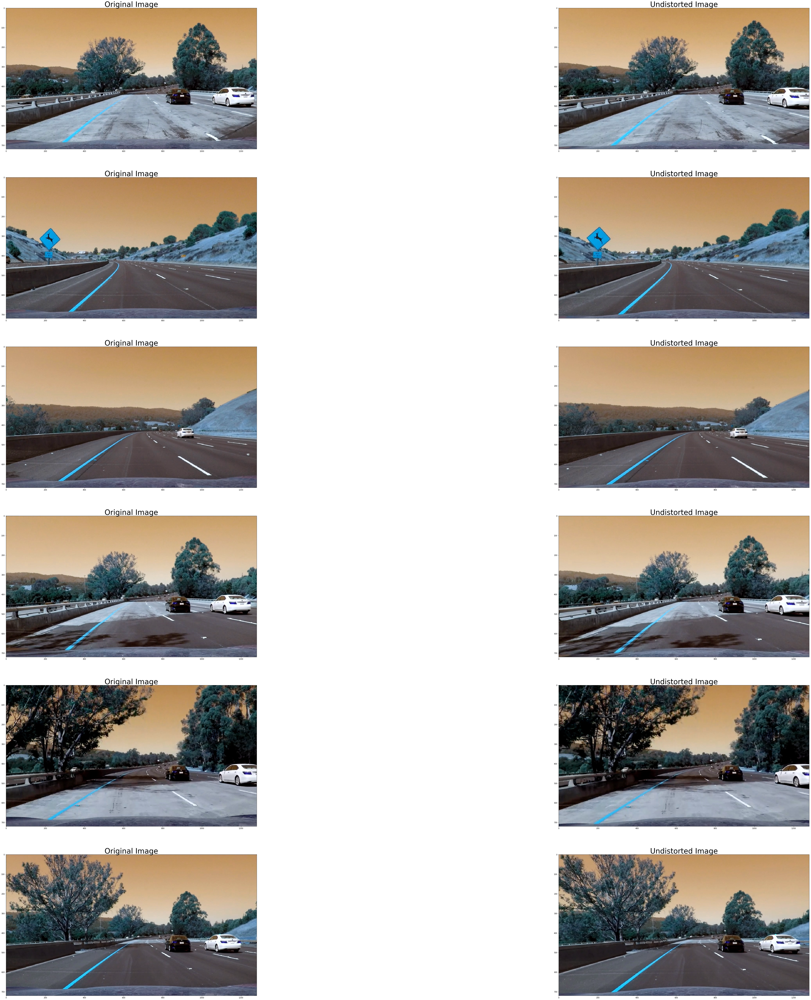

In [2]:
test_images = glob.glob('./test_images/test*.jpg')

fig, ax = plt.subplots(6,2,figsize=(100,100))
i = 0

for test_fname in test_images:
    test_img = cv2.imread(test_fname)
    ax[i][0].imshow(test_img)
    ax[i][0].set_title(str('Original Image'), fontsize=40)
    test_undist = cv2.undistort(test_img, mtx, dist, None, mtx)
    cv2.imwrite('./output_images/test_undist' + str(i+1) + '.jpg', test_undist)
    ax[i][1].imshow(test_undist)
    ax[i][1].set_title(str('Undistorted Image'), fontsize=40)
    i = i + 1
    
fig.savefig('./output_images/undistort_test.jpg')
plt.show()

## Use Gradient, Color Threshold to Create a Thresholded Binary Image

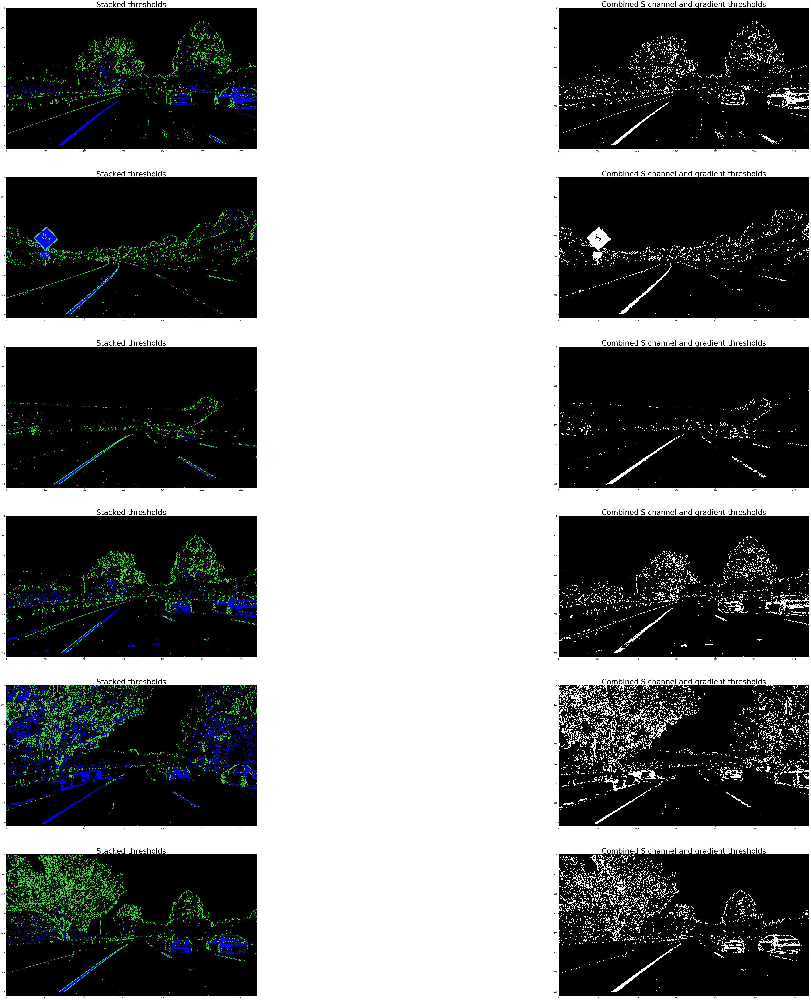

In [4]:
test_undist = glob.glob('./output_images/test_undist*.jpg')

fig, ax = plt.subplots(6,2,figsize=(100,100))
i = 0

for test_fname in test_undist:
    img = cv2.imread(test_fname)
    # Convert to HLS color space and separate the S channel
    # Note: img is the undistorted image
    hls = cv2.cvtColor(img, cv2.COLOR_BGR2HLS)
    s_channel = hls[:,:,2]
    
    # Grayscale image
    # NOTE: we already saw that standard grayscaling lost color information for the lane lines
    # Explore gradients in other colors spaces / color channels to see what might work better
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # Sobel x
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    thresh_min = 30
    thresh_max = 100
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1
    
    # Threshold color channel
    s_thresh_min = 170
    s_thresh_max = 255
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh_min) & (s_channel <= s_thresh_max)] = 1
    
    # Stack each channel to view their individual contributions in green and blue respectively
    # This returns a stack of the two binary images, whose components you can see as different colors
    color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, s_binary)) * 255
    
    # Combine the two binary thresholds
    combined_binary = np.zeros_like(sxbinary)
    combined_binary[(s_binary == 1) | (sxbinary == 1)] = 1
    
    cv2.imwrite('./output_images/test_binary' + str(i+1) + '.jpg', combined_binary * 255)
    
    # Plotting thresholded images
    ax[i][0].set_title('Stacked thresholds', fontsize=40)
    ax[i][0].imshow(color_binary)
    
    ax[i][1].set_title('Combined S channel and gradient thresholds', fontsize=40)
    ax[i][1].imshow(combined_binary, cmap='gray')
    i = i + 1

fig.savefig('./output_images/binary_test.jpg')
plt.show()

## Perspective Transform to Birds-Eye View

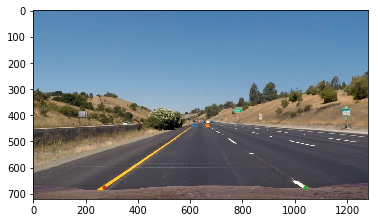

In [5]:
import matplotlib.image as mpimg
img = mpimg.imread('./test_images/straight_lines1.jpg')
plt.imshow(img)
#Draw sample points
plt.plot(613,439,'.') # top left
plt.plot(665,439,'.') # top right
plt.plot(1040,675,'.') # bottom right 
plt.plot(269,675,'.') # bottom left

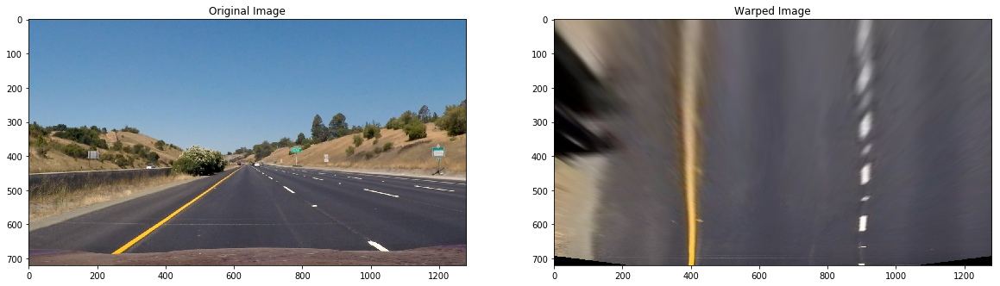

In [6]:
# Four source coordinates
src = np.float32(
   [[613,439],
    [665,439],
    [1040,675],
    [269,675]])

# Four desired coordinates
dst = np.float32(
   [[400,1],
    [900,1],
    [900,720],
    [400,720]])

M = cv2.getPerspectiveTransform(src, dst)

img_size = (img.shape[1], img.shape[0])

warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.set_title('Original Image')
ax1.imshow(img)

ax2.set_title('Warped Image')
ax2.imshow(warped)

## Apply Perspective Transform to Binary Images

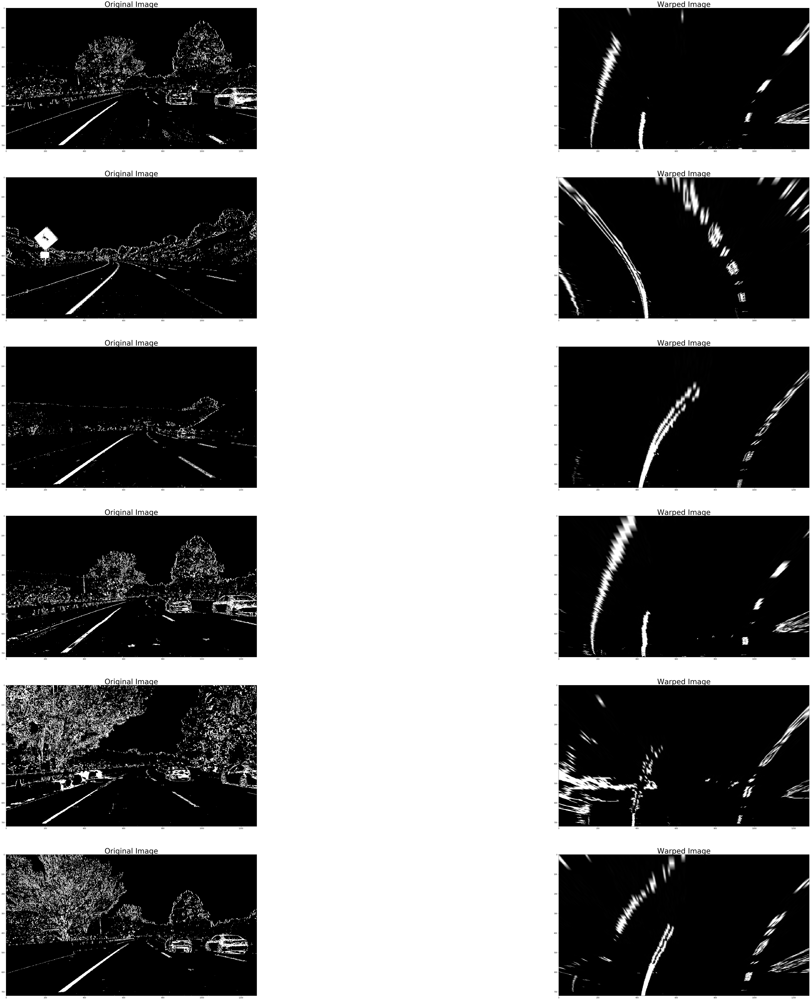

In [7]:
test_binary = glob.glob('./output_images/test_binary*.jpg')

fig, ax = plt.subplots(6,2,figsize=(100,100))
i = 0

for test_fname in test_binary:
    test_img = cv2.imread(test_fname)
    ax[i][0].imshow(test_img)
    ax[i][0].set_title(str('Original Image'), fontsize=40)
    img_size = (test_img.shape[1], test_img.shape[0])
    warped = cv2.warpPerspective(test_img, M, img_size, flags=cv2.INTER_LINEAR)
    cv2.imwrite('./output_images/test_warped' + str(i+1) + '.jpg', warped)
    ax[i][1].imshow(warped)
    ax[i][1].set_title(str('Warped Image'), fontsize=40)
    i = i + 1
    
fig.savefig('./output_images/warped_test.jpg')
plt.show()